This homework is mainly about image processing, where we will enhance and filter a specific image.

# Preparations

The target image will be converted to a numpy matrix using `imageio`.

In [51]:
import imageio
from skimage import exposure
import matplotlib.pyplot as plt
import numpy as np
import cv2
%matplotlib inline
%config InlineBackend.rc = {'figure.dpi': 320}
%config InlineBackend.figure_format = 'png'
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

Image roman.jpg loaded: (1440 x 900)


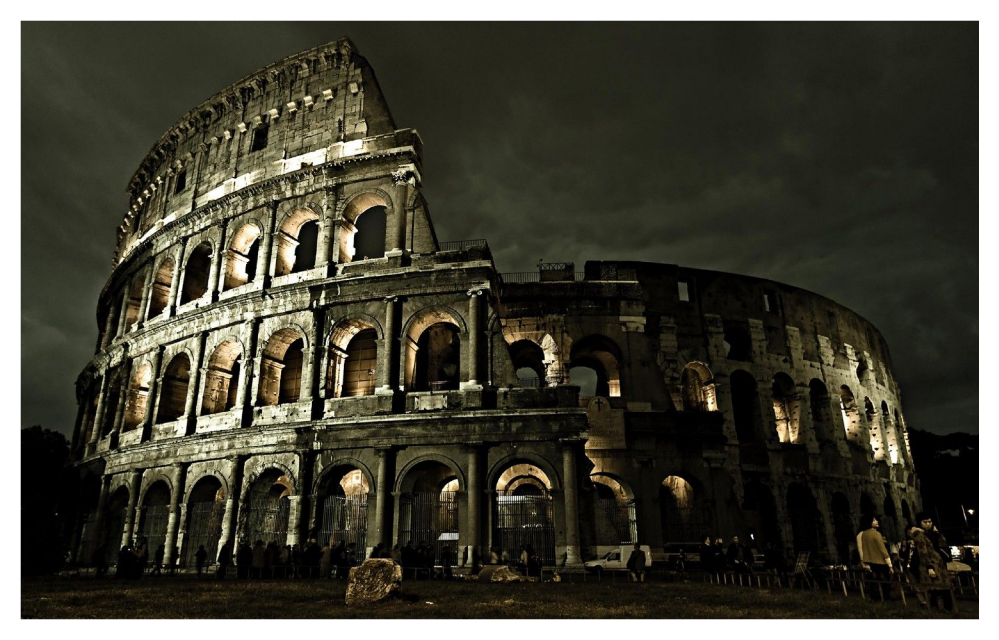

In [25]:
src_image_path = "roman.jpg"

def read_image(path):
    return imageio.imread(path)

def save_image(path, image):
    imageio.imwrite(path, image, format='png')

def show_image(arr, **kwargs):
    plt.axis('off')
    plt.imshow(arr, **kwargs)

src_image = read_image(src_image_path)
print("Image {} loaded: ({} x {})".format(src_image_path, src_image.shape[1], src_image.shape[0]))
show_image(src_image)
save_image("images/src.png", src_image)

# Problem 1

## 1.1 Generate grayscale image from the R channel

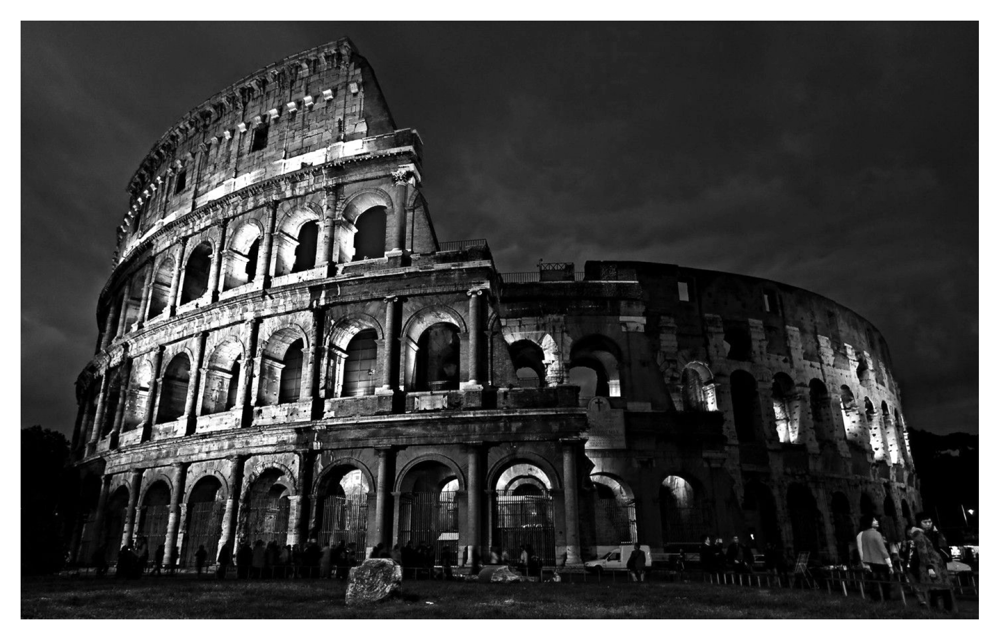

In [27]:
src_red = src_image[:, :, 0]
show_image(src_red, cmap='gray')
save_image("images/src_R_grayscale.png", src_red)

## 1.2 Enhance the image with histogram equalization

We will use the `equalize_hist` function from the `skimage` module to enhance the grayscale image.

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


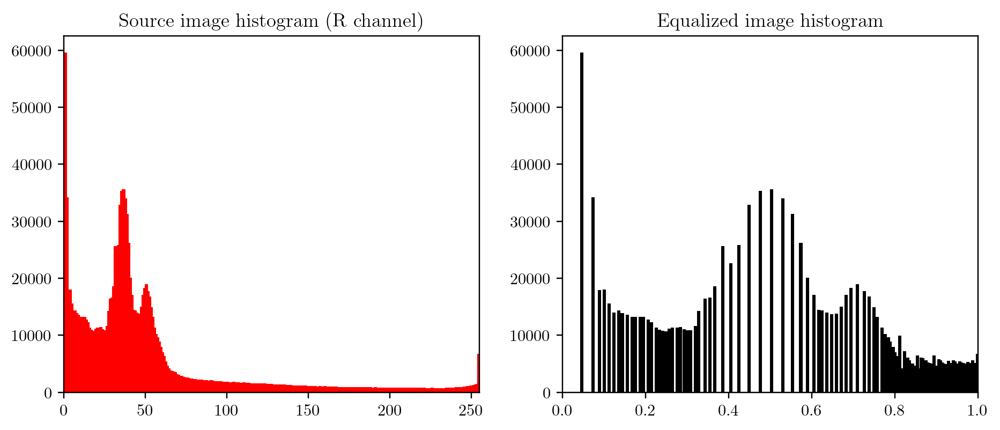

In [86]:
eq_red = exposure.equalize_hist(src_red)
save_image("images/src_R_eq.png", eq_red)

# Show the histograms of both images
plt.figure(dpi=220, figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.hist(src_red.flatten(), bins=256, range=(0, 255), ec='red', fc='red')
plt.xlim(0, 255)
plt.title('Source image histogram (R channel)', loc="center")
plt.subplot(1, 2, 2)
plt.hist(eq_red.ravel(), bins=256, range=(0.0, 1.0), ec='k', fc='k')
plt.xlim([0.0, 1.0])
plt.title('Equalized image histogram', loc="center")
plt.subplots_adjust(wspace=0.2)
plt.show()

We see from the above image that the histogram spreads out over the entire range of pixel values in the equalized histogram, hence we affirm that the image output is working as expected.

# Problem 2

## 2.1 Use exponential distribution to match the histogram of the image

Here we will use the `match_histograms` function from the `skimage` module to match the histogram of the image.

Lossy conversion from float64 to uint8. Range [0.047314245281897226, 15.798753446298184]. Convert image to uint8 prior to saving to suppress this warning.


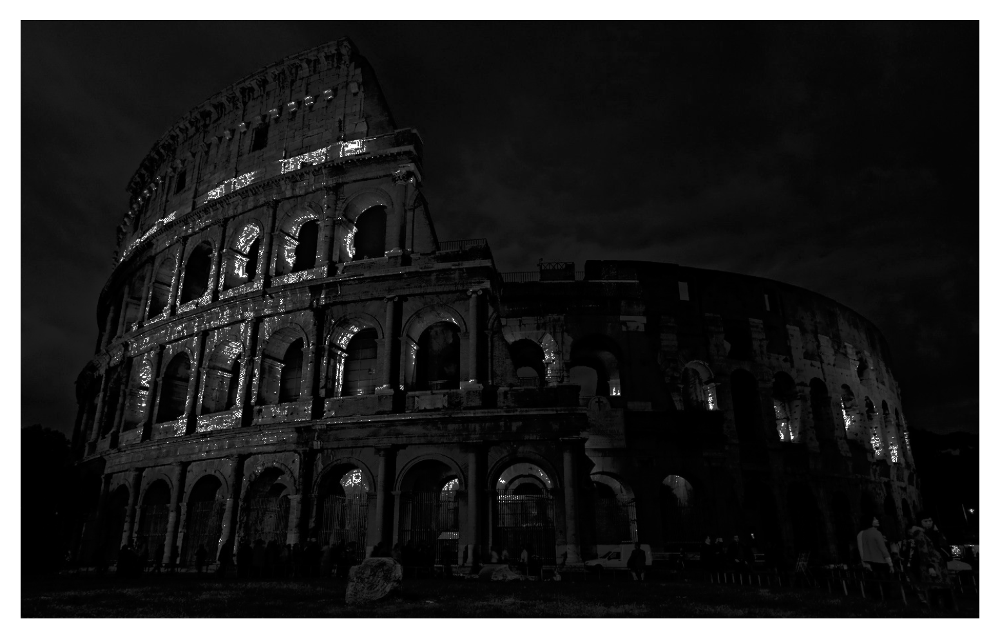

In [77]:
# Create the exponential distribution of identical size
exp_distribution = np.random.exponential(size=src_red.shape)
# Match the histogram of the image
exp_matched_red = exposure.match_histograms(src_red, exp_distribution)
# Show the result
show_image(exp_matched_red, cmap='gray')
save_image("images/src_R_matched_exp.png", exp_matched_red)


We see that the image is darker than the original image. Similarly, we'll compare the histogram of the image with the histogram of the original image.

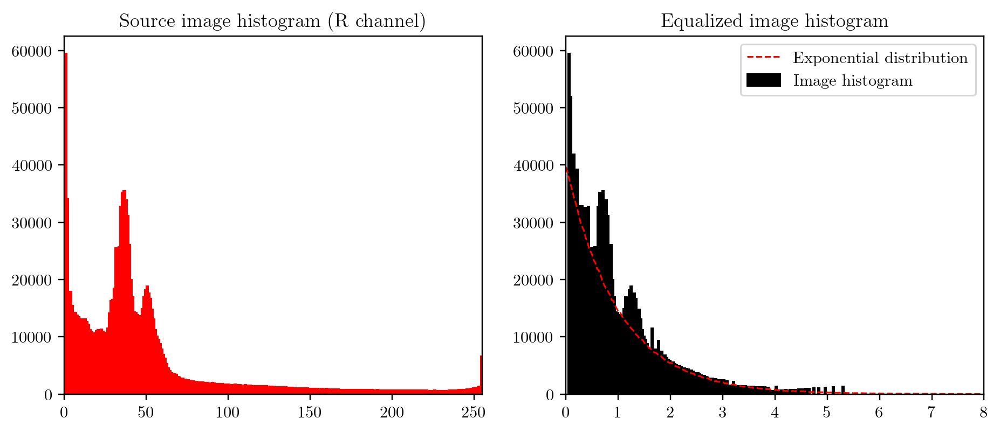

In [101]:
# Show the histograms of both images
plt.figure(dpi=220, figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.hist(src_red.flatten(), bins=256, range=(0, 255), ec='red', fc='red')
plt.xlim(0, 255)
plt.title('Source image histogram (R channel)', loc="center")
plt.subplot(1, 2, 2)
plt.hist(exp_matched_red.flatten(), bins=256, range=(0.0, 8.0), ec='k', fc='k')
# Line-style hist for exp distribution
n, x, _ = plt.hist(exp_distribution.flatten(), bins=256, range=(0.0, 8.0), ec='r', fc='r', alpha=0)
plt.plot(x[:-1], n, 'r--', linewidth=1)
plt.legend(['Exponential distribution', 'Image histogram'], loc="upper right")
plt.xlim([0.0, 8.0])
plt.title('Equalized image histogram', loc="center")
plt.subplots_adjust(wspace=0.2)
plt.show()

We see that the histogram of the processed image is much alike to exponenetial distribution, hence we affirm that the image output is working as expected.

## 2.2 Use Gaussian distribution to match the histogram of the image

Lossy conversion from float64 to uint8. Range [-1.6847300761121298, 5.190763058438374]. Convert image to uint8 prior to saving to suppress this warning.


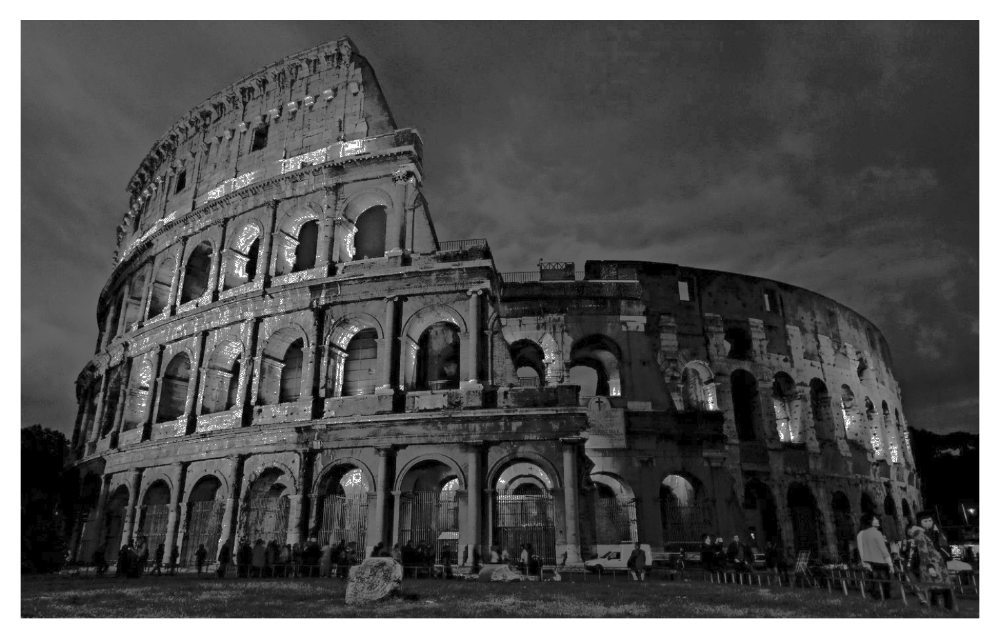

In [100]:
# Create the Gaussian distribution of identical size
gaussian_distribution = np.random.normal(size=src_red.shape)
# Match the histogram of the image
gaussian_matched_red = exposure.match_histograms(src_red, gaussian_distribution)
# Show the result
show_image(gaussian_matched_red, cmap='gray')
save_image("images/src_R_matched_gaussian.png", gaussian_matched_red)

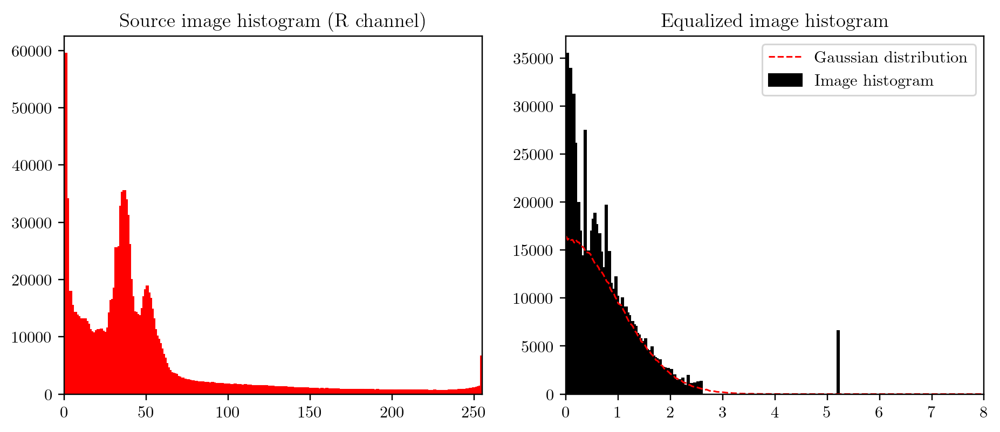

In [102]:
# Show the histograms of both images
plt.figure(dpi=220, figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.hist(src_red.flatten(), bins=256, range=(0, 255), ec='red', fc='red')
plt.xlim(0, 255)
plt.title('Source image histogram (R channel)', loc="center")
plt.subplot(1, 2, 2)
plt.hist(gaussian_matched_red.flatten(), bins=256, range=(0.0, 8.0), ec='k', fc='k')
# Line-style hist for gaussian distribution
n, x, _ = plt.hist(gaussian_distribution.flatten(), bins=256, range=(0.0, 8.0), ec='r', fc='r', alpha=0)
plt.plot(x[:-1], n, 'r--', linewidth=1)
plt.legend(['Gaussian distribution', 'Image histogram'], loc="upper right")
plt.xlim([0.0, 8.0])
plt.title('Equalized image histogram', loc="center")
plt.subplots_adjust(wspace=0.2)
plt.show()

The result is also as expected.

# Problem 3: Matching the histogram of the image with a custom distribution

Histogram matching is a very common task in image processing. Here we will use a special distribution to match the histogram of the image: Gamma distribution.

$$
\begin{align}
f(x;\alpha,\beta) & = \frac{ x^{\alpha-1} e^{-\beta x} \beta^\alpha}{\Gamma(\alpha)} \quad \text{ for } x > 0 \quad \alpha, \beta > 0, \\[6pt]
\Gamma(\alpha) &= (\alpha - 1)! \quad \text{ for } \alpha > 0.
\end{align}
$$

It's such a fun thing to see how the image evolves over different choice of $\alpha$ and $\beta$. Therefore I made a matrix for them!

Lossy conversion from float64 to uint8. Range [0.04686332489032355, 17.132637074077678]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.0942010405091525, 28.65813646918947]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.18731154699543484, 61.559977313234405]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.3789154473435378, 125.60995841414295]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.3382678692598206, 19.66257732784066]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.6795090875160964, 36.30392817047958]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [1.348683333433539, 71.12107239552121

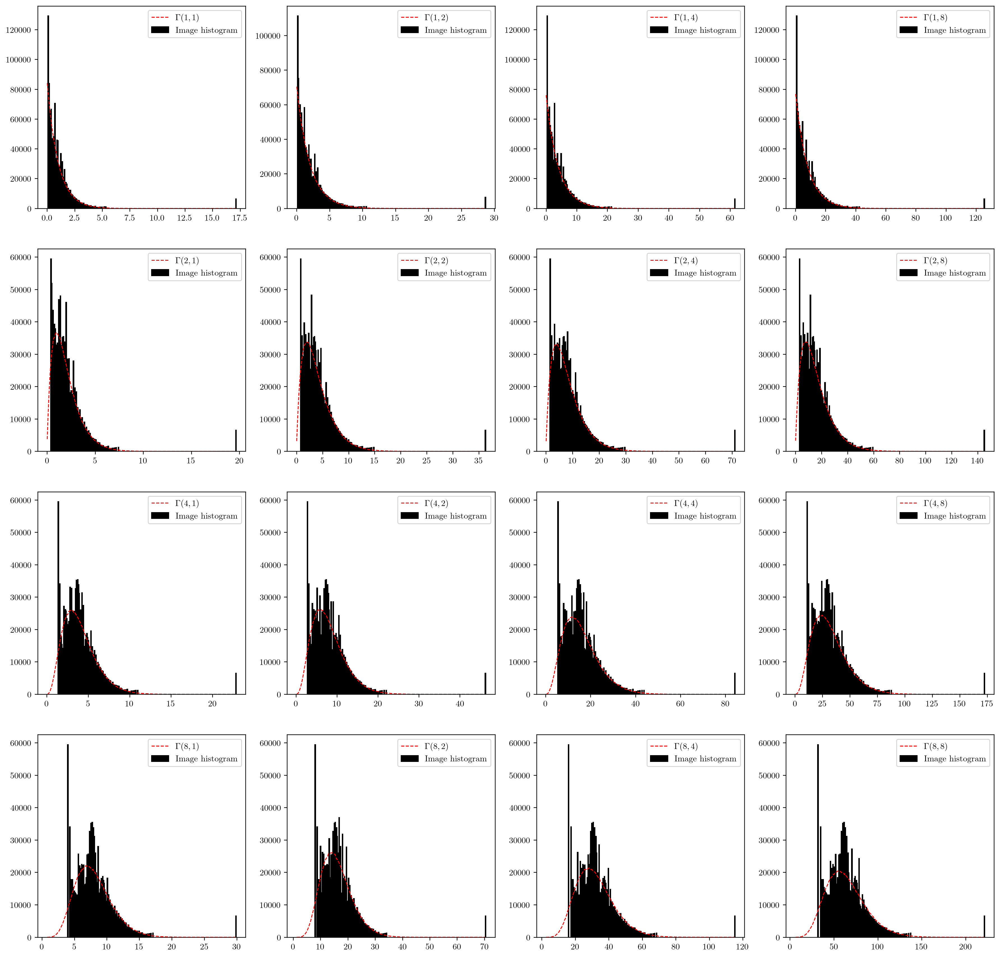

In [116]:
alpha_choices = [1, 2, 4, 8]
beta_choices = [1, 2, 4, 8]
gamma_matched_output = {}

plt.figure(dpi=220, figsize=(20, 20))
for alpha in alpha_choices:
    for beta in beta_choices:
        # Create the Gamma distribution of identical size
        gamma_distribution = np.random.gamma(alpha, beta, size=src_red.shape)
        # Match the histogram of the image
        gamma_matched_red = exposure.match_histograms(src_red, gamma_distribution)
        # Append
        gamma_matched_output[(alpha, beta)] = gamma_matched_red
        # Show the result
        plt.subplot(len(alpha_choices), len(beta_choices), alpha_choices.index(alpha) * len(beta_choices) + beta_choices.index(beta) + 1)
        plt.hist(gamma_matched_red.flatten(), bins=256, ec='k', fc='k')
        # Line-style hist for gamma distribution
        n, x, _ = plt.hist(gamma_distribution.flatten(), bins=256, ec='r', fc='r', alpha=0)
        plt.plot(x[:-1], n, 'r--', linewidth=1)
        plt.legend([f'$\Gamma({alpha}, {beta})$', 'Image histogram'], loc="upper right")
        save_image("images/gamma/src_R_matched_gamma_{}_{}.png".format(alpha, beta), gamma_matched_red)
        

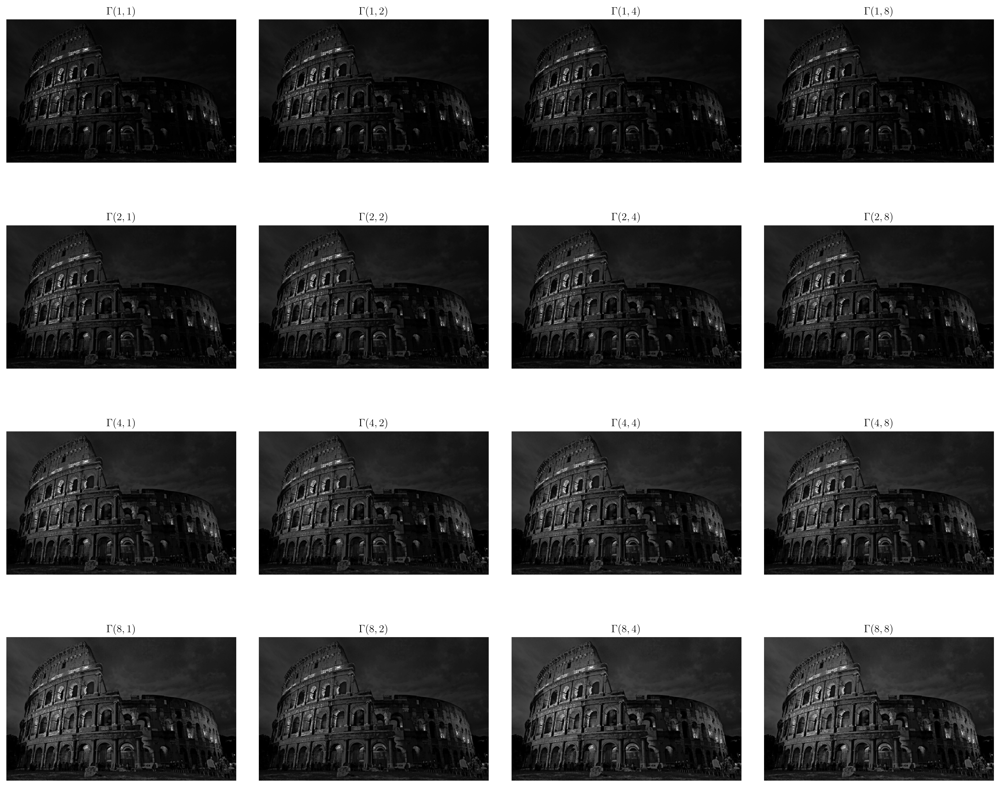

In [120]:
# And plot the images
plt.figure(dpi=220, figsize=(20, 20))
for alpha in alpha_choices:
    for beta in beta_choices:
        plt.subplot(len(alpha_choices), len(beta_choices), alpha_choices.index(alpha) * len(beta_choices) + beta_choices.index(beta) + 1)
        show_image(gamma_matched_output[(alpha, beta)], cmap='gray')
        plt.title(f'$\Gamma({alpha}, {beta})$')
# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.1)
plt.subplots_adjust(hspace=-0.4)
plt.show()

We see that with bigger choice of $\alpha$ and $\beta$, the image becomes brighter. This can be seen from the histograms, as the distribution moves slowly onwards to the right, the histogram of the image will also move slowly towards the right, resulting in a brighter image.

# Problem 4: Histogram equalization for all (R, G, B) channels

Very similar implementation as Problem 1.

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


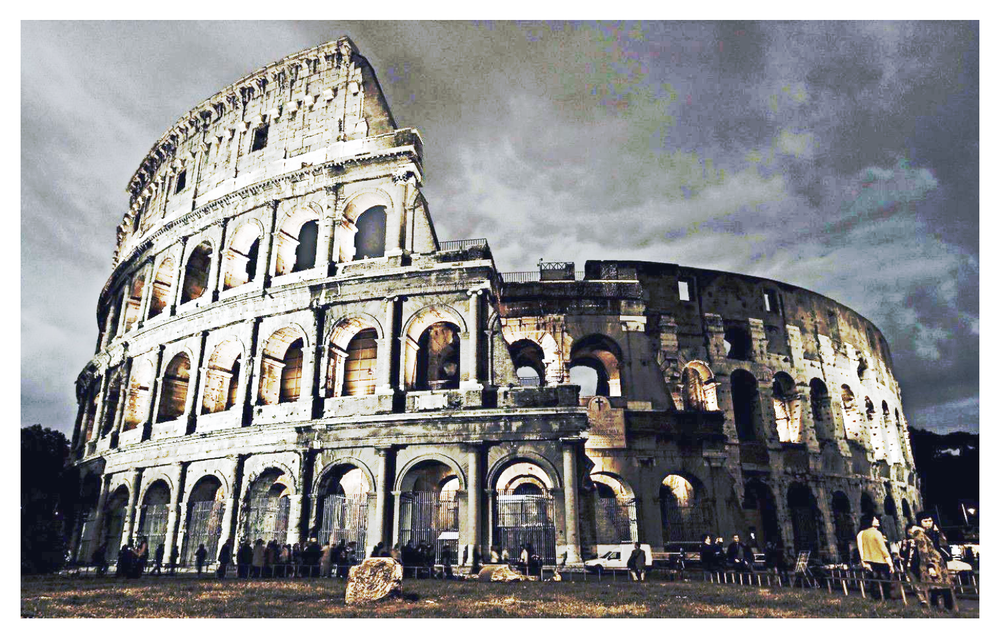

In [122]:
def eq_hist(arr):
    return exposure.equalize_hist(arr)

src_red, src_green, src_blue = src_image[:, :, 0], src_image[:, :, 1], src_image[:, :, 2]
eq_red, eq_green, eq_blue = eq_hist(src_red), eq_hist(src_green), eq_hist(src_blue)
# Create the image
eq_image = np.dstack((eq_red, eq_green, eq_blue))
# Show the result
show_image(eq_image)
save_image("images/src_eq_hist.png", eq_image)

> We can also apply `skimage.exposure.equalize_hist` directly to the 3-channel image, the result is NOT the same. This will be discussed in [problem 5](#problem-5-problems).

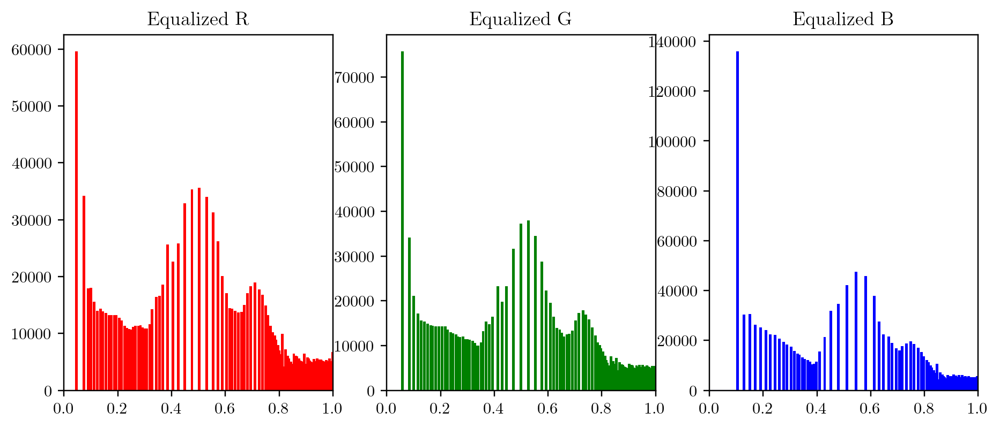

In [125]:
# Plot the histograms of all channels
plt.figure(dpi=220, figsize=(10, 4))
plt.subplot(1, 3, 1)
plt.hist(eq_red.flatten(), bins=256, range=(0, 1), ec='red', fc='red')
plt.xlim(0, 1)
plt.title('Equalized R', loc="center")
plt.subplot(1, 3, 2)
plt.hist(eq_green.flatten(), bins=256, range=(0, 1), ec='green', fc='green')
plt.xlim(0, 1)
plt.title('Equalized G', loc="center")
plt.subplot(1, 3, 3)
plt.hist(eq_blue.flatten(), bins=256, range=(0, 1), ec='blue', fc='blue')
plt.xlim(0, 1)
plt.title('Equalized B', loc="center")
plt.subplots_adjust(wspace=0.2)
plt.show()


# Problem 5: Problems?

**No!**

Sceptically speaking, problems only exist when we are facing a specific **task**, but not a procedure. A procedure only has right or wrong, but no *good or bad*. Therefore, the problem itself is NOT well-defined, which should not be present in the homework.

But let's experiment with the default RGB image histogram equalization with our channel-wise histogram equalization. Are they identical?


c:\Program Files\Python39\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


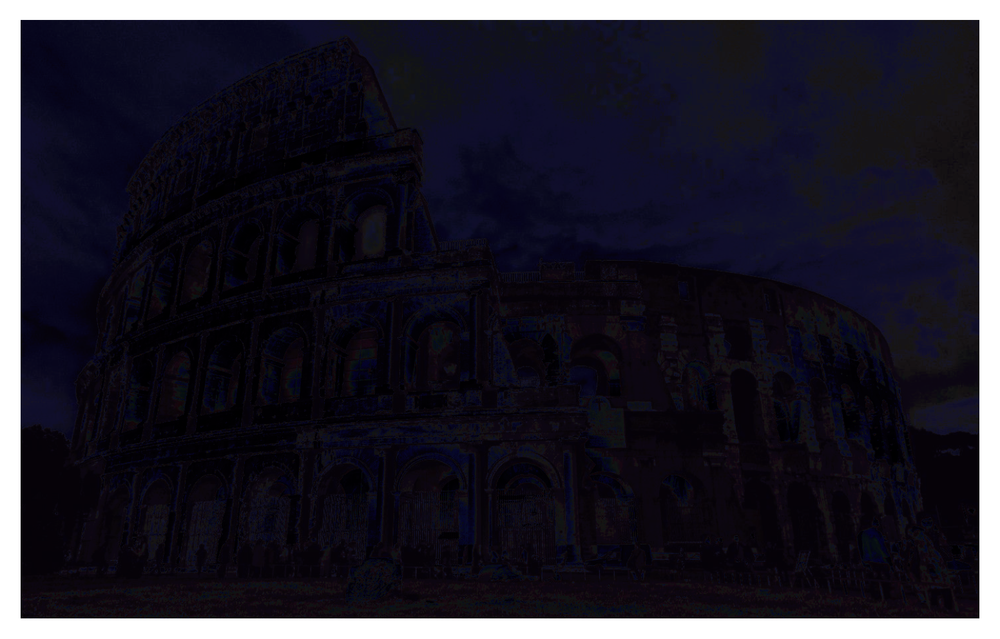

In [130]:
eq_image_2 = eq_hist(src_image)
# Compare the result with eq_image
delta_image = np.abs(eq_image - eq_image_2)
# Show the result
show_image(delta_image)

It can be seen that the channel-wise implementation is not identical to the original implementation. What's happening under the hood?

## Reasoning

To understand how the difference occurs, we need to understand the underlying process of histogram equalization.

**Histogram equalization is a non-linear process.** Channel splitting and equalizing each channel separately is incorrect. Equalization involves intensity values of the image, not the color components. So for a simple RGB color image, histogram equalization cannot be applied directly on the channels. It needs to be applied in such a way that the intensity values are equalized **without disturbing the color balance of the image**. So, the first step is to convert the color space of the image from RGB into one of the color spaces that separates intensity values from color components.

## Implementation

One good thing I choose Python instead of MATLAB is that I can see every step of the process from the source code. It is obvious that `skimage` feels something bad about computing histogram equalization with a colored image, as it says:

```
UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
```

But how? Diving into the source code, `skimage` implements `equalize_hist` as follows:

```python
def equalize_hist(image, nbins=256, mask=None):
    if mask is not None:
        mask = np.array(mask, dtype=bool)
        cdf, bin_centers = cumulative_distribution(image[mask], nbins)
    else:
        cdf, bin_centers = cumulative_distribution(image, nbins)
    out = np.interp(image.flat, bin_centers, cdf)
    out = out.reshape(image.shape)
    return out.astype(utils._supported_float_type(image.dtype), copy=False)
```

With no `mask` given, the function will calculate the cumulative distribution function for the entire image. The function `cumulative_distribution` is defined as follows:

```python
def cumulative_distribution(image, nbins=256):
    hist, bin_centers = histogram(image, nbins)
    img_cdf = hist.cumsum()
    img_cdf = img_cdf / float(img_cdf[-1])

    cdf_dtype = utils._supported_float_type(image.dtype)
    img_cdf = img_cdf.astype(cdf_dtype, copy=False)

    return img_cdf, bin_centers
```

And the function `histogram` is defined as follows:

```python
@utils.channel_as_last_axis(multichannel_output=False)
def histogram(image, nbins=256, source_range='image', normalize=False, *,
              channel_axis=None):
    sh = image.shape
    if len(sh) == 3 and sh[-1] < 4 and channel_axis is None:
        utils.warn('This might be a color image. The histogram will be '
                   'computed on the flattened image. You can instead '
                   'apply this function to each color channel, or set '
                   'channel_axis.')

    if channel_axis is not None:
        channels = sh[-1]
        hist = []

        # compute bins based on the raveled array
        if np.issubdtype(image.dtype, np.integer):
            # here bins corresponds to the bin centers
            bins = _bincount_histogram_centers(image, source_range)
        else:
            # determine the bin edges for np.histogram
            hist_range = _get_numpy_hist_range(image, source_range)
            bins = _get_bin_edges(image, nbins, hist_range)

        for chan in range(channels):
            h, bc = _histogram(image[..., chan], bins, source_range, normalize)
            hist.append(h)
        # Convert to numpy arrays
        bin_centers = np.asarray(bc)
        hist = np.stack(hist, axis=0)
    else:
        hist, bin_centers = _histogram(image, nbins, source_range, normalize)

    return hist, bin_centers
```

If `channel_axis` is not set, the histogram is computed on the flattened image. For color or multichannel images, set ``channel_axis`` to use a common binning for all channels. Alternatively, one may apply the function separately on each channel to obtain a histogram for each color channel with separate binning.

A *flattened* image is a combined array of all the pixels of each channel in the image. This means that all 3 channels are taken into consideration when computing the histogram. This helps to avoid the problem of color balance, making one specific channel too bright than the other two.

So it seems that the RGB image should not be histogram-equalized by simply separating the channels. What should we do instead?

## Solution

The answer is an alternative color space. There are many different color spaces aside from RGB, each with its own set of color components. For example, the CIE XYZ color space has 3 components, while the CIE L\*a\*b\* color space has 4.

Some of the possible options are HSV/HLS, YUV, YCbCr, etc.. YCbCr is preferred as it is designed for digital images. Perform histogram equalization on the intensity plane Y, and then convert the resultant YCbCr image back to RGB.

In [137]:
def RGB2YCbCr(ch_r, ch_g, ch_b):
    # Based on ITU-R BT.601 standard
    Y  = ch_r *  0.29900 + ch_g *  0.58700 + ch_b *  0.11400
    Cb = ch_r * -0.16874 + ch_g * -0.33126 + ch_b *  0.50000 + 128
    Cr = ch_r *  0.50000 + ch_g * -0.41869 + ch_b * -0.08131 + 128
    return Y, Cb, Cr

def YCbCr2RGB(ch_y, ch_cb, ch_cr):
    # Based on ITU-R BT.601 standard
    R  = ch_y +                          + (ch_cr - 128) *  1.40200
    G  = ch_y + (ch_cb - 128) * -0.34414 + (ch_cr - 128) * -0.71414
    B  = ch_y + (ch_cb - 128) *  1.77200
    return R, G, B


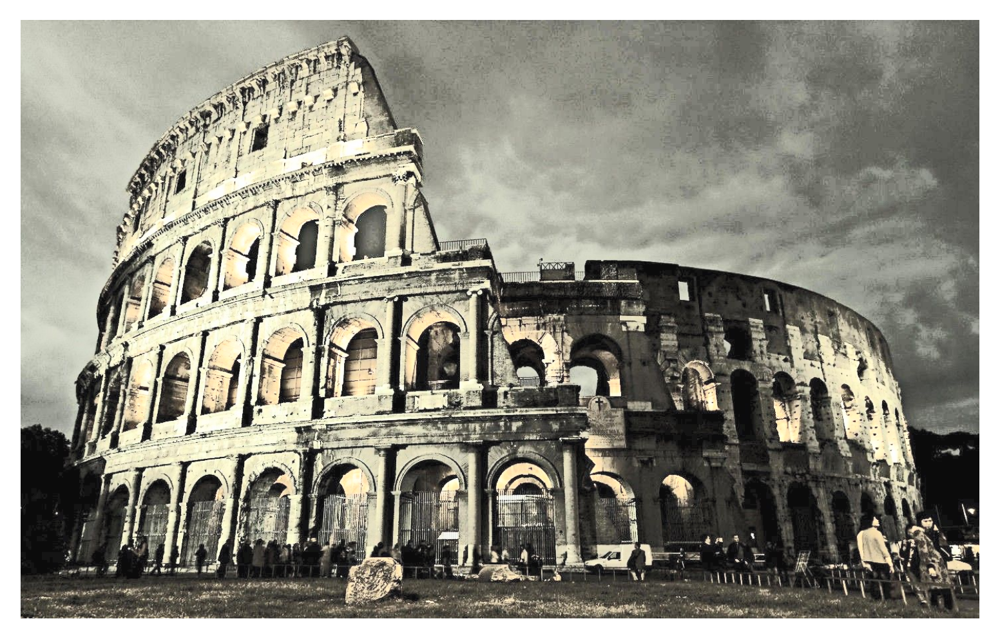

In [159]:
# Convert src_img to YCbCr
src_ycrcb = cv2.cvtColor(src_image, cv2.COLOR_RGB2YCrCb)
src_y, src_cr, src_cb = src_ycrcb[:, :, 0], src_ycrcb[:, :, 1], src_ycrcb[:, :, 2]
# Equalize histogram on Y channel
eq_y = eq_hist(src_y) * 255
# Convert back to RGB
eq_ycbcr = np.dstack((eq_y, src_cr, src_cb))
eq_ycbcr = np.uint8(eq_ycbcr)
eq_image_from_ycbcr = cv2.cvtColor(eq_ycbcr, cv2.COLOR_YCrCb2RGB)
# Show the result
show_image(eq_image_from_ycbcr)

We see that the problem of a color tinting has been resolved. As the Y-channel is the intensity channel, the overall color balance is maintained, which gives a better result than the original per-channel histogram equalization.

# Conclusion

That's all for this assignment. During the whole task, we've toured through image processing and how to match image histograms with a specific distribution. We also tried to compare channel-wise histogram equalization with the Y-channel histogram equalization, based on the fact that the Y-channel is the intensity channel. We see a significant image quality boost as we switched our color space from RGB to YCbCr.

The world of DSP is growing rapidly. There are many tools and algorithms to process and enhance imges, and we shall continue to explore them.

It's quite a pity that this assignment may be the last programming assignment. If you are a student who is also interested in DSIP, congratulations for covering this repo, and thanks for your time. I hope this repository will be useful to you.

# License

The above code is under MIT License.